# Homework Assignment 1
### [The Art of Analyzing Big Data - The Data Scientist’s Toolbox](https://www.ise.bgu.ac.il/labs/fire/lectures.html)
#### By Dr. Michael Fire 

For this homework you will need to write code that analyzes real-world datasets. The code needs to be written in Python using the [sqlite3](https://docs.python.org/2/library/sqlite3.html) package. 

**Please note:** You need to answer only the questions that match your ID first digit.

# 1. Babies Names Dataset (35pt)

**Task 1 (for everyone):** Write a code that uses the  [**babies names dataset** ](https://www.kaggle.com/kaggle/us-baby-names?select=NationalNames.csv) (use NationalNames.csv) and creates a table named (Names) with the dataset data and the following columns: 'State', 'Gender', 'Name', 'Count' , and 'Year' (5pt)
**Bonus:** Load the data using a Batch INSERT SQL Query (2pt)

In [ ]:
import json
import numpy as np
import sqlite3
import pandas as pd
import timeit
import matplotlib.pyplot as plt
%matplotlib inline


In [ ]:
!mkdir /root/.kaggle/
# Installing the Kaggle package
!pip install kaggle 

#!!!fill your api key!!!
api_token = {"username":"","key":""}

with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

# Creating a dataset directory
!mkdir ./datasets
!mkdir ./datasets/us-baby-name
# Creating a database directory
!mkdir ./databases
!mkdir ./databases/us-baby-name

# download the dataset from Kaggle and unzip it
# !kaggle datasets download kaggle/us-baby-names -f NationalNames.csv -p ./datasets/us-baby-name/NationalNames
!kaggle datasets download kaggle/us-baby-names -f StateNames.csv -p ./datasets/us-baby-name/StateNames
# !unzip ./datasets/us-baby-name/NationalNames/*.zip  -d ./datasets/us-baby-name/NationalNames
!unzip ./datasets/us-baby-name/StateNames/*.zip  -d ./datasets/us-baby-name/StateNames


# Load data
# df_national = pd.read_csv('./datasets/us-baby-name/NationalNames/NationalNames.csv')
df_state = pd.read_csv('./datasets/us-baby-name/StateNames/StateNames.csv')

# samples_national = df_national.values.tolist()
samples_state = df_state.values.tolist()


 92% 28.0M/30.5M [00:01<00:00, 12.9MB/s]
100% 30.5M/30.5M [00:01<00:00, 25.2MB/s]
Archive:  ./datasets/us-baby-name/StateNames/StateNames.csv.zip
  inflating: ./datasets/us-baby-name/StateNames/StateNames.csv  


In [ ]:
def print_rows(rows, count):
  for index, row in enumerate(rows):
    if index == count:
      break
    # row_str = f"{index}, "
    row_str = ""
    for column in row:
      row_str = row_str + f"{column}, " 
    print(row_str)

In [ ]:
# DB creation and connection
conn = sqlite3.connect('./databases/us-baby-name/database.sqlite')
cur = conn.cursor() 

# Assuming the addition of id column is approved (as in the original data csv file)
# If the addition of id column is not approved then use the next code section, change id_column_allowed to False
# id_column_allowed = False

# if id_column_allowed:
# SQL Query
sql_create_table_with_id = """ CREATE TABLE IF NOT EXISTS Names (
                                    id integer PRIMARY KEY,
                                    Name text NOT NULL,
                                    State text NOT NULL,
                                    Gender text NOT NULL,
                                    Count integer,
                                    Year integer
                                ); """

cur.execute(sql_create_table_with_id)

# Single insert
# cur.execute("insert into Names (id, Name, Year, Gender, State, Count) values (?, ?, ?, ?, ?, ?)", (88888888, "test_name", "test_state", "F", 11, 1972))

### BONUS - Note that 2 different methods of batch insert are implemented
# Batch insert - execute many method
cur.executemany("insert into Names (id, Name, Year, Gender, State, Count) values (?, ?, ?, ?, ?, ?)", samples_state)

# Batch insert - transaction method
# cur.execute("BEGIN TRANSACTION")
# for sample in samples_state:
#   cur.execute("insert into Names (id, Name, Year, Gender, State, Count) values (?, ?, ?, ?, ?, ?)", sample)
# cur.execute("COMMIT")

# else:
#   # If the addition of id column is not approved then use this code section

#   # SQL Query
#   sql_create_table_without_id = """ CREATE TABLE IF NOT EXISTS Names (
#                                       Name text NOT NULL,
#                                       State text NOT NULL,
#                                       Gender text NOT NULL,
#                                       Count integer,
#                                       Year integer,
#                                       PRIMARY KEY (Name, Gender, State)
#                                   ); """
#   cur.execute(sql_create_table_without_id)
#   # Single insert
#   # cur.execute("insert into Names (Name, Year, Gender, State, Count) values (?, ?, ?, ?, ?)", ("test_name", "test_state", "F", 11, 1972))

#   samples_state = [sample[1:] for sample in samples_state] #removing id column

#   ### BONUS - Note that 2 different methods of batch insert are implemented
#   # Batch insert - execute many method
#   cur.executemany("insert into Names (Name, Year, Gender, State, Count) values (?, ?, ?, ?, ?)", samples_state)

#   # Batch insert - transaction method
#   # cur.execute("BEGIN TRANSACTION")
#   # for sample in samples_state:
#   #   cur.execute("insert into Names (Name, Year, Gender, State, Count) values (?, ?, ?, ?, ?)", sample)
#   # cur.execute("COMMIT")


# Printing results of the insertion and closing connection
print("The number of names is: %s" % cur.execute("SELECT count(*) FROM Names" ).fetchone())
print("select * from Names:")
print_rows(cur.execute("SELECT * FROM Names").fetchall(), count=10)

cur.close()

The number of names is: 5647426
select * from Names:
1, Mary, AK, F, 14, 1910, 
2, Annie, AK, F, 12, 1910, 
3, Anna, AK, F, 10, 1910, 
4, Margaret, AK, F, 8, 1910, 
5, Helen, AK, F, 7, 1910, 
6, Elsie, AK, F, 6, 1910, 
7, Lucy, AK, F, 6, 1910, 
8, Dorothy, AK, F, 5, 1910, 
9, Mary, AK, F, 12, 1911, 
10, Margaret, AK, F, 7, 1911, 


**Task 2 (for everyone):** Write a query that returns the statistics for the name Mary (5pt). Use the [the timeit package](https://docs.python.org/3/library/timeit.html) to measure the time it takes the query to run (5pt). **Bonus:** [Create an index](https://www.w3schools.com/sql/sql_create_index.asp)  on the _Name_ column and use the [the timeit package](https://docs.python.org/3/library/timeit.html) to measure the time it takes the query to run with the index (5pt)

In [ ]:
cur = conn.cursor()  
#queries results
print("First query results - printing 5 rows")
print("Name, Year, Gender, State, Count")
response_rows = cur.execute("SELECT Name, Year, Gender, State, Count FROM Names where Name='Mary'").fetchall()
print_rows(response_rows, count=5)
print("\nSecond query results")
print("Name, total, distinct Years, distinct states, distinct genders")
response_rows = cur.execute("SELECT Name, sum(Count) ,count(distinct(Year)), count(distinct(State)), count(distinct(Gender)) FROM Names where Name='Mary'").fetchall()
print_rows(response_rows, count=20)

# Timing with no index
print("\nFirst query timing - No index")
%timeit cur.execute("SELECT * FROM Names where Name='Mary'").fetchall()
%time cur.execute("SELECT * FROM Names where Name='Mary'").fetchall()
print("\nSecond query timing - No index")
%timeit cur.execute("SELECT Name, sum(Count) ,count(distinct(Year)), count(distinct(State)), count(distinct(Gender)) FROM Names where Name='Mary'").fetchall()
%time cur.execute("SELECT Name, sum(Count) ,count(distinct(Year)), count(distinct(State)), count(distinct(Gender)) FROM Names where Name='Mary'").fetchall()

### BONUS
# Creating index
print("\nCreating index")
create_index_query = "CREATE INDEX Name_index ON Names (Name);"
cur.execute(create_index_query)

# Timing with index
print("First query timing - with index")
%timeit cur.execute("SELECT * FROM Names where Name='Mary'").fetchall()
%time cur.execute("SELECT * FROM Names where Name='Mary'").fetchall()
print("\nSecond query timing - with index")
%timeit cur.execute("SELECT Name, sum(Count) ,count(distinct(Year)), count(distinct(State)), count(distinct(Gender)) FROM Names where Name='Mary'").fetchall()
%time cur.execute("SELECT Name, sum(Count) ,count(distinct(Year)), count(distinct(State)), count(distinct(Gender)) FROM Names where Name='Mary'").fetchall()

print("\nAfter Index creation the execution times reduced drastically")
cur.close()

First query results - printing 5 rows
Name, Year, Gender, State, Count
Mary, 1910, F, AK, 14, 
Mary, 1911, F, AK, 12, 
Mary, 1912, F, AK, 9, 
Mary, 1913, F, AK, 21, 
Mary, 1914, F, AK, 22, 

Second query results
Name, total, distinct Years, distinct states, distinct genders
Mary, 3740495, 105, 51, 2, 

First query timing - No index
1 loop, best of 5: 413 ms per loop
CPU times: user 399 ms, sys: 40.3 ms, total: 440 ms
Wall time: 441 ms

Second query timing - No index
1 loop, best of 5: 396 ms per loop
CPU times: user 376 ms, sys: 37.7 ms, total: 413 ms
Wall time: 412 ms

Creating index
First query timing - with index
10 loops, best of 5: 20.4 ms per loop
CPU times: user 15.1 ms, sys: 8.99 ms, total: 24 ms
Wall time: 23.9 ms

Second query timing - with index
100 loops, best of 5: 12.6 ms per loop
CPU times: user 5.84 ms, sys: 6.97 ms, total: 12.8 ms
Wall time: 12.8 ms

After Index creation the execution times reduced drastically


### <span style="color:red"> Please answer only **one** of the following questions according to your ID number (use the formula **<YOUR_ID> mod 4 +1**) </span>

In [ ]:
# which question to answer - put your ID number and run the code 
your_id  = "312141369"
q = int(your_id) % 4 + 1
print("You need to answer question number %s" % q)

You need to answer question number 2


***Question 1:*** Write a function that returns how many babies were born in a given state in a given year.
Use it to calculate the number of babies born in TX in 1986 (10pt)

***Question 2:*** Write a function that returns how many female babies were born between a given range of years.
Use it to calculate how many babies were born between 1988 and 1995  (10pt)

In [ ]:
start_year = "1988"
end_year = "1995"
include_end_year = False

def get_females_born_between_years(start_year, end_year, include_end_year, connetcion):
  cur = connetcion.cursor()
  
  year_range = "("
  for year in range(int(start_year),int(end_year)):
    year_range = year_range + '\"' + str(year) + '\",'
  if include_end_year:
    year_range = year_range + '\"' + end_year + '\")'
  else: 
    year_range = year_range[:-1] + ")"

  females_born_between_years_query = "select sum(Count) From Names WHERE Year IN %s"% year_range
  print(f"Query: {females_born_between_years_query}")
  r = cur.execute(females_born_between_years_query).fetchall()
  
  total = r[0][0]

  cur.close()
  return total

total_born = get_females_born_between_years(start_year=start_year, end_year=end_year, include_end_year=include_end_year, connetcion=conn)
print(f"total born: {total_born}")

Query: select sum(Count) From Names WHERE Year IN ("1988","1989","1990","1991","1992","1993","1994")
total born: 23997933


**Question 3:** Write a function that returns the most common female name in a given state. Use it to calculate the most common female name in Wasington in 1987 (10pt)

**Question 4:** Write a function that returns how many male babies named _Robert where born in a given state in a given year. Use it to find the state in which the highest number of babies _Robert_ where born in 2010 (10pt)

**Question (for everyone):** For the state of CA write code that calculates the second most popular female/male names in each decade (10pt). **Bonus**: Visualize it somehow using Matplotlib (5pt)

Query: select Name, Gender, Year, Count from Names where State='CA' Order by Year 
daceades_second_most_popular: {'1910': {'name': 'John', 'count': 7826}, '1920': {'name': 'Mary', 'count': 17781}, '1930': {'name': 'Richard', 'count': 17792}, '1940': {'name': 'John', 'count': 42704}, '1950': {'name': 'Robert', 'count': 66503}, '1960': {'name': 'David', 'count': 73017}, '1970': {'name': 'Jennifer', 'count': 54896}, '1980': {'name': 'Christopher', 'count': 61902}, '1990': {'name': 'Daniel', 'count': 50139}, '2000': {'name': 'Anthony', 'count': 37259}, '2010': {'name': 'Jacob', 'count': 15054}}


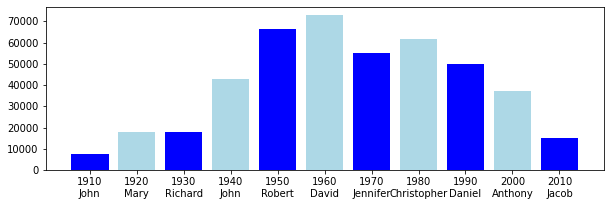

In [ ]:
state = "CA"

def get_second_most_popular(state, connetcion):
  cur = connetcion.cursor()

  names_count_query = "select Name, Gender, Year, Count from Names where State='%s' Order by Year "% state
  print(f"Query: {names_count_query}")
  rows = cur.execute(names_count_query).fetchall()
  df = pd.DataFrame(rows, columns =['Name', 'Gender', 'Year', 'Count'])

  daceades_second_most_popular = {}

  unique_years = df.Year.unique()
  start_of_daceades_years = list(range(unique_years[0], unique_years[-1]+1, 10))
  for start_of_daceade_year in start_of_daceades_years:
    daceade_years = list(range(start_of_daceade_year, start_of_daceade_year+10))
    
    df_daceade = df[df['Year'].isin(daceade_years)]
    daceade_total_count = {}
    for index, row in df_daceade.iterrows():
      if row.Name not in daceade_total_count.keys():
        daceade_total_count[row.Name] = 0
      daceade_total_count[row.Name] = daceade_total_count[row.Name] + row.Count
    
    sorted_by_total_count = sorted(daceade_total_count.items(), key=lambda item: item[1])
    daceades_second_most_popular[str(start_of_daceade_year)] = {"name": sorted_by_total_count[-2][0], "count": sorted_by_total_count[-2][1]} 
  daceades_second_most_popular

  cur.close()
  return daceades_second_most_popular

daceades_second_most_popular = get_second_most_popular(state=state, connetcion=conn)
print(f"\ndaceades_second_most_popular: {daceades_second_most_popular}\n")

###Bonus
# Plotting
years = []
values = []
for key, value in daceades_second_most_popular.items():
  years.append(key+"\n" + value["name"]) 
  values.append(value["count"])

fig, ax = plt.subplots(figsize=(10, 3))
ax.bar(years, values, color=["b","lightblue"] )

plt.show()


# 2. Flavors of Cacao Dataset (15pt)

Using the [Flavors of Cacao](https://www.kaggle.com/rombikuboktaeder/choco-flavors) dataset, answer the following questions:

**Question 1:** Write a function that returns the number of bars manufactured where the bars' BroadBean Origin is a given country. Use the function to calculate the number of bars where BroadBean Origin is 'Fiji' (15pt)

**Question 2:** Write a function that returns the maximal and average cocoa percentage in a bar manufactured by a company in a specific country. Use the function to calculate the minimal and average cocoa percentage in bars manufactured by a Swiss company (15pt).


In [ ]:
# Creating a dataset directory
!mkdir ./datasets/flavors_of_cacao
# Creating a database directory
!mkdir ./databases/flavors_of_cacao
# download the dataset from Kaggle and unzip it
!kaggle datasets download rombikuboktaeder/choco-flavors -f flavors_of_cacao.csv -p ./datasets/flavors_of_cacao
!unzip ./datasets/flavors_of_cacao/*.zip  -d ./datasets/flavors_of_cacao
# Load data
df_cacao = pd.read_csv('./datasets/flavors_of_cacao/flavors_of_cacao.csv')
df_cacao['Cocoa\nPercent'] = df_cacao['Cocoa\nPercent'].apply(lambda x: x[:-1])
samples_cacao = df_cacao.values.tolist()
samples_cacao = [[index] + row for index, row in enumerate(samples_cacao)]

# DB creation and connection
conn = sqlite3.connect('./databases/flavors_of_cacao/flavors_of_cacao.sqlite')
cur = conn.cursor() 

# SQL Query
create_table_with_id_cacao_query = """ 
CREATE TABLE IF NOT EXISTS Cocoa (
  id integer PRIMARY KEY,
  Company text NOT NULL,
  SpecificBeanOriginOrBarName	 text NOT NULL,
  REF integer NOT NULL,
  ReviewDate integer NOT NULL,
  CocoaPercent integer NOT NULL,
  CompanyLocation text NOT NULL,
  Rating real NOT NULL,
  BeanType test,
  BroadBeanOrigin text
); """

cur.execute(create_table_with_id_cacao_query)

# Batch insert - execute many method
cur.executemany("Insert into Cocoa (id, Company, SpecificBeanOriginOrBarName, REF, ReviewDate, CocoaPercent, CompanyLocation, Rating, BeanType, BroadBeanOrigin) values (?, ?, ?, ?, ?, ?, ? ,? ,? ,?)", samples_cacao)
cur.close()


  0% 0.00/125k [00:00<?, ?B/s]
100% 125k/125k [00:00<00:00, 46.3MB/s]
unzip:  cannot find or open ./datasets/flavors_of_cacao/*.zip, ./datasets/flavors_of_cacao/*.zip.zip or ./datasets/flavors_of_cacao/*.zip.ZIP.

No zipfiles found.


In [ ]:
company_country = "Switzerland"


def get_stats_cocoa_percentage_by_company_country(company_country, connetcion):
  cur = connetcion.cursor()
  

  stats_cocoa_percentage_by_company_country_query = f"""select max(CocoaPercent), min(CocoaPercent), avg(CocoaPercent) from Cocoa where CompanyLocation == '{company_country}' """

  print(f"Query: {stats_cocoa_percentage_by_company_country_query}")
  rows = cur.execute(stats_cocoa_percentage_by_company_country_query).fetchall()
  max_cocoa_percentage_by_company_country = rows[0][0]
  min_cocoa_percentage_by_company_country = rows[0][1]
  avg_cocoa_percentage_by_company_country = rows[0][2]

  cur.close()
  return max_cocoa_percentage_by_company_country,min_cocoa_percentage_by_company_country,avg_cocoa_percentage_by_company_country

max_cocoa_percentage, min_cocoa_percentage, avg_cocoa_percentage = get_stats_cocoa_percentage_by_company_country(company_country=company_country, connetcion=conn)
print(f"company's country: {company_country}")
print(f"min cocoa percentage: {min_cocoa_percentage}")
print(f"max cocoa percentage: {max_cocoa_percentage}")
print(f"avg cocoa percentage: {avg_cocoa_percentage}")

Query: select max(CocoaPercent), min(CocoaPercent), avg(CocoaPercent) from Cocoa where CompanyLocation == 'Switzerland' 
88, 58, 71.21052631578948, 
company's country: Switzerland
min cocoa percentage: 58
max cocoa percentage: 88
avg cocoa percentage: 71.21052631578948


**Question 3:** Calculate the second most common bean type(s) and the most rare bean type(s) (15
pt)

**Question 4:** Calculate the number of reviews and the average rating in each year. Calculate the number of reviews and the average rating of each company in each year (15pt)

# 3. Kickstarter Projects Dataset (25pt)

Using the [Kickstarter Projects Dataset](https://www.kaggle.com/kemical/kickstarter-projects#ks-projects-201801.csv), answer the following questions:

**Task 1 (for everyone):** Load the dataset to SQLite DB using [PonyORM](https://ponyorm.org) (10pt)

In [ ]:
!pip install pony
# Creating a dataset directory
!mkdir ./datasets/kickstarter
# Creating a database directory
!mkdir ./databases/kickstarter
# download the dataset from Kaggle and unzip it
!kaggle datasets download kemical/kickstarter-projects -f ks-projects-201801.csv -p ./datasets/kickstarter
!unzip ./datasets/kickstarter/*.zip  -d ./datasets/kickstarter
# Load data
df_kickstarter = pd.read_csv('./datasets/kickstarter/ks-projects-201801.csv')
# samples_kickstarter = df_kickstarter.values.tolist()


     |████████████████████████████████| 290 kB 4.3 MB/s 
  Created wheel for pony: filename=pony-0.7.14-py3-none-any.whl size=351293 sha256=5deea31489b747ac667f6dd95e4507ea8751f4d5fc7ba376df2adaa965c6a766
  Stored in directory: /root/.cache/pip/wheels/de/7a/8b/82a3b5a0135fc6bad188f62e1bf6c4843142bc22c144879014
Successfully built pony
 93% 19.0M/20.4M [00:00<00:00, 15.3MB/s]
100% 20.4M/20.4M [00:00<00:00, 34.6MB/s]
Archive:  ./datasets/kickstarter/ks-projects-201801.csv.zip
  inflating: ./datasets/kickstarter/ks-projects-201801.csv  


In [ ]:
from pony.orm import *
from datetime import date, datetime
# Creating a new database
db_kickstarter = Database()
db_kickstarter.bind(provider='sqlite', filename='/content/databases/kickstarter/kickstarter.pony.db', create_db=True) 


class KickstarterProject(db_kickstarter.Entity):
  id = PrimaryKey(int)
  name = Optional(str)
  category = Required(str)
  main_category = Required(str)
  currency = Required(str)
  deadline = Required(date)
  goal = Required(float)
  launched = Required(datetime)
  pledged = Required(float)
  state = Required(str)
  backers = Required(int)
  country = Required(str)
  usd_pledged = Optional(float)
  usd_pledged_real = Required(float)
  usd_goal_real = Required(float)

show(KickstarterProject)

class KickstarterProject(Entity):
    id = PrimaryKey(int)
    name = Optional(str, default='')
    category = Required(str)
    main_category = Required(str)
    currency = Required(str)
    deadline = Required(date)
    goal = Required(float)
    launched = Required(datetime)
    pledged = Required(float)
    state = Required(str)
    backers = Required(int)
    country = Required(str)
    usd_pledged = Optional(float)
    usd_pledged_real = Required(float)
    usd_goal_real = Required(float)


In [ ]:
set_sql_debug(True) # helps to see what SQL commands are running
db_kickstarter.generate_mapping(create_tables=True) # create tables

GET CONNECTION FROM THE LOCAL POOL
PRAGMA foreign_keys = false
BEGIN IMMEDIATE TRANSACTION
CREATE TABLE "KickstarterProject" (
  "id" INTEGER NOT NULL PRIMARY KEY,
  "name" TEXT NOT NULL,
  "category" TEXT NOT NULL,
  "main_category" TEXT NOT NULL,
  "currency" TEXT NOT NULL,
  "deadline" DATE NOT NULL,
  "goal" REAL NOT NULL,
  "launched" DATETIME NOT NULL,
  "pledged" REAL NOT NULL,
  "state" TEXT NOT NULL,
  "backers" INTEGER NOT NULL,
  "country" TEXT NOT NULL,
  "usd_pledged" REAL,
  "usd_pledged_real" REAL NOT NULL,
  "usd_goal_real" REAL NOT NULL
)

SELECT "KickstarterProject"."id", "KickstarterProject"."name", "KickstarterProject"."category", "KickstarterProject"."main_category", "KickstarterProject"."currency", "KickstarterProject"."deadline", "KickstarterProject"."goal", "KickstarterProject"."launched", "KickstarterProject"."pledged", "KickstarterProject"."state", "KickstarterProject"."backers", "KickstarterProject"."country", "KickstarterProject"."usd_pledged", "KickstarterP

In [ ]:
kickstarter_projects = []
for idx, row in df_kickstarter.iterrows():
  if row["name"] is np.nan:
    kickstarter_projects.append(KickstarterProject(id=row["ID"] , name=str(row["ID"]), category=row["category"] ,main_category=row["main_category"], currency=row["currency"], deadline=row["deadline"], goal=row["goal"], launched=row["launched"], pledged=row["pledged"], state=row["state"] , backers=row["backers"], country=row["country"], usd_pledged=row["usd pledged"], usd_pledged_real=row["usd_pledged_real"], usd_goal_real=row["usd_goal_real"]))
  else:
    kickstarter_projects.append(KickstarterProject(id=row["ID"] , name=row["name"], category=row["category"] ,main_category=row["main_category"], currency=row["currency"], deadline=row["deadline"], goal=row["goal"], launched=row["launched"], pledged=row["pledged"], state=row["state"] , backers=row["backers"], country=row["country"], usd_pledged=row["usd pledged"], usd_pledged_real=row["usd_pledged_real"], usd_goal_real=row["usd_goal_real"]))
commit()

Streaming output truncated to the last 5000 lines.
[19206997, 'La Petite Machine', 'Illustration', 'Art', 'EUR', '2016-04-19', 6000.0, '2016-02-19 17:19:04.000000', 8215.0, 'successful', 151, 'FR', 9150.84, 9252.58, 6757.82]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1920700633, 'The NJ Burlesque Showcase', 'Theater', 'Theater', 'USD', '2012-07-19', 2500.0, '2012-06-18 13:25:52.000000', 326.0, 'failed', 8, 'US', 326.0, 326.0, 2500.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[1920705451, 'Women of the West', 'Documentary', 'Film & Video', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[2007161648, 'Lustre (Canceled)', 'Hip-Hop', 'Music', 'USD', '2015-03-15', 60000.0, '2015-01-29 03:15:10.000000', 0.0, 'canceled', 0, 'US', 0.0, 0.0, 60000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[200716444, 'Be the first in the world to use and love BTR Bums diapers!', 'Product Design', 'Design', 'CAD', '2015-05-17', 15000.0, '2015-04-02 20:17:24.000000', 2152.0, 'failed', 26, 'CA', 1698.83, 1763.93, 12295.08]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2007170044, 'Connections Gallery

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[2102215189, 'Restaurant Shuffle', 'Apps', 'Technology', 'USD', '2016-05-25', 2000.0, '2016-04-25 17:05:56.000000', 11.0, 'failed', 2, 'US', 11.0, 11.0, 2000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[210221610, 'Publishing a Book-How to Build an Inter-Stellar Spaceship', 'Nonfiction', 'Publishing', 'USD', '2014-03-04', 5000.0, '2014-02-02 21:42:45.000000', 30.0, 'failed', 1, 'US', 30.0, 30.0, 5000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2102226331, 'The Black Aurora Modular Poker 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[2135252524, 'Eiger. Wingsuit flight film', 'Action', 'Film & Video', 'GBP', '2016-02-01', 15000.0, '2016-01-05 16:41:38.000000', 275.0, 'failed', 5, 'GB', 404.83, 400.2, 21829.29]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[21352554, 'The Apache Stories Series', 'Mixed Media', 'Art', 'USD', '2012-07-20', 500.0, '2012-07-17 17:05:18.000000', 205.0, 'failed', 7, 'US', 205.0, 205.0, 500.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[2135257012, 'Delicious Failure', 'Food', 'Food', 'USD', '2012-

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[244155305, "Lucid Dream's Dog Stew", 'Small Batch', 'Food', 'USD', '2017-06-02', 2000.0, '2017-04-24 20:22:41.000000', 214.0, 'failed', 4, 'US', 0.0, 214.0, 2000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[244155469, 'Digitize Village Picture Shows!', 'Film & Video', 'Film & Video', 'USD', '2013-03-15', 175000.0, '2013-01-14 23:42:35.000000', 195043.0, 'successful', 1006, 'US', 195043.0, 195043.0, 175000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[244156469, 'Grand Slam', 'Product Desi

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[27899056, 'Bless You - A Short Dramedy', 'Shorts', 'Film & Video', 'USD', '2011-04-08', 600.0, '2011-03-19 21:58:21.000000', 796.0, 'successful', 31, 'US', 796.0, 796.0, 600.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[279004356, 'The Oregon Tree Company-A revoution in logging & forestry', 'Technology', 'Technology', 'USD', '2015-10-18', 50000.0, '2015-09-18 18:51:08.000000', 95.0, 'canceled', 4, 'US', 95.0, 95.0, 50000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[279007120, 'Player Aid 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[315702817, 'San Fermin - Sin Igual: Unparalleled', 'Documentary', 'Film & Video', 'USD', '2012-06-17', 10000.0, '2012-05-08 10:21:52.000000', 10056.0, 'successful', 52, 'US', 10056.0, 10056.0, 10000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[315705252, "Frankie's London A PKU Friendly Adventure", "Children's Books", 'Publishing', 'USD', '2017-11-17', 10000.0, '2017-09-18 02:06:16.000000', 0.0, 'failed', 0, 'US', 0.0, 0.0, 10000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[315707568, 'A

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[352325900, 'The e-recite', 'Technology', 'Technology', 'USD', '2017-12-31', 50000.0, '2017-11-22 17:37:03.000000', 12.0, 'failed', 1, 'US', 0.0, 12.0, 50000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[35232682, "Move Clothing-Unique Sportswear 'From Athletes For Athletes'", 'Apparel', 'Fashion', 'EUR', '2016-09-24', 20000.0, '2016-08-18 12:03:05.000000', 265.0, 'failed', 6, 'DE', 146.59, 295.77, 22321.93]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[352330491, 'Soft Paws AB/DL Adult Diaper

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[390507531, 'Minus Touch want to prove that Rock is not dead!', 'Rock', 'Music', 'USD', '2013-01-15', 3000.0, '2012-11-16 18:15:33.000000', 520.0, 'failed', 7, 'US', 520.0, 520.0, 3000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[390509359, 'Cats Without Borders', 'Documentary', 'Film & Video', 'USD', '2015-01-30', 3000.0, '2014-12-31 17:19:17.000000', 131.0, 'failed', 4, 'US', 131.0, 131.0, 3000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[390518686, 'R.A.K.E (Random Acts of Kindness by 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[429651266, 'Around the world in 80 ways !', 'Places', 'Photography', 'GBP', '2014-08-22', 15000.0, '2014-07-23 00:30:50.000000', 0.0, 'failed', 0, 'GB', 0.0, 0.0, 24866.14]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[429654464, 'Unique Double-Debossed Silicone Wedding Ring', 'Jewelry', 'Fashion', 'USD', '2016-03-11', 2000.0, '2016-02-10 17:42:05.000000', 31.0, 'failed', 3, 'US', 31.0, 31.0, 2000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[429661751, 'Cancer Reject App - Future of Cancer P

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[470106627, 'Innovation Club', 'Technology', 'Technology', 'USD', '2014-05-08', 5000.0, '2014-04-08 17:43:13.000000', 628.0, 'failed', 7, 'US', 628.0, 628.0, 5000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[470109778, 'Shakti - of science & traditions', 'Documentary', 'Film & Video', 'GBP', '2013-08-08', 40000.0, '2013-07-09 13:19:06.000000', 48.5, 'failed', 5, 'GB', 72.19, 75.3, 62102.16]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[470117918, 'Syzygryd Burning Man 2010', 'Sculpture', 'Art

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[508827146, '"The Rita Hayworth of this Generation"', 'Theater', 'Theater', 'USD', '2013-08-25', 5000.0, '2013-07-26 17:45:07.000000', 5286.0, 'successful', 100, 'US', 5286.0, 5286.0, 5000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[508829775, 'Remembering Your Loved Ones Forever (MEMORY PACKS)', 'Crafts', 'Crafts', 'USD', '2015-05-31', 4150.0, '2015-05-01 05:41:33.000000', 0.0, 'failed', 0, 'US', 0.0, 0.0, 4150.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[508833731, 'Angry Bunny- Round 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[548232221, 'Groot Watch - 100% Bone Handcrafted Watch', 'Product Design', 'Design', 'SGD', '2017-06-18', 15000.0, '2017-05-19 14:01:21.000000', 838.0, 'failed', 2, 'SG', 301.57, 604.23, 10815.49]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[548235910, 'Learn any language in 90 days', 'Nonfiction', 'Publishing', 'CAD', '2014-08-09', 2500.0, '2014-07-10 02:33:16.000000', 60.0, 'failed', 2, 'CA', 56.2, 55.05, 2293.58]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[548242169, 'Summiting Mount Kilima

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[587671896, 'CIAC Trash Process', 'Technology', 'Technology', 'USD', '2016-01-17', 1000.0, '2015-12-08 02:13:31.000000', 60.0, 'failed', 3, 'US', 60.0, 60.0, 1000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[587687992, "Michael Cuomo's Heads of State at Art Expo 2014", 'Sculpture', 'Art', 'USD', '2014-04-01', 3000.0, '2014-03-13 22:53:34.000000', 3090.0, 'successful', 23, 'US', 3090.0, 3090.0, 3000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[587696020, 'Foxfire-Legend of the Nine Tailed 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[627116419, "I'm A Survivor! (Canceled)", 'Documentary', 'Film & Video', 'USD', '2011-08-10', 6500.0, '2011-05-12 16:12:50.000000', 0.0, 'canceled', 0, 'US', 0.0, 0.0, 6500.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[627118610, 'Nani Makeup, Lipstains', 'Fashion', 'Fashion', 'EUR', '2016-06-11', 50000.0, '2016-05-16 16:55:03.000000', 0.0, 'failed', 0, 'FR', 0.0, 0.0, 56270.19]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[627119040, 'Publicity Project for "Cures vs. Profits" (Dr. Lyons-Weile

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[666869344, 'Turning barriers in life, into challenges to live life.', 'Nonfiction', 'Publishing', 'USD', '2013-06-08', 5000.0, '2013-05-09 16:45:00.000000', 220.0, 'failed', 2, 'US', 220.0, 220.0, 5000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[666870048, 'DIRTY WORKS video series seeks funding', 'Shorts', 'Film & Video', 'USD', '2011-03-08', 500.0, '2011-01-27 03:39:47.000000', 1.0, 'failed', 1, 'US', 1.0, 1.0, 500.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[666871683, 'Zyde: Strateg

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[706520850, 'BLANK: The Graphic Novel Series (Book 1 of 7)', 'Comics', 'Comics', 'USD', '2012-09-30', 95000.0, '2012-08-01 18:46:50.000000', 32105.9, 'failed', 141, 'US', 32105.9, 32105.9, 95000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[706522753, 'The Molded Witch Soap Shop', 'Textiles', 'Art', 'USD', '2015-02-20', 5000.0, '2015-01-21 00:56:39.000000', 0.0, 'failed', 0, 'US', 0.0, 0.0, 5000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[706530388, 'AeroTrainer: Improve athletic performa

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[749580912, 'Collection Armor', 'Comics', 'Comics', 'USD', '2013-08-14', 5000.0, '2013-07-09 16:15:29.000000', 890.0, 'failed', 17, 'US', 890.0, 890.0, 5000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[749592272, 'Unique Gift', 'Art', 'Art', 'USD', '2014-04-24', 60000.0, '2014-02-23 15:02:03.000000', 40.0, 'failed', 2, 'US', 40.0, 40.0, 60000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[749594990, 'Garage Beacon - The iBeacon + BLE enabled garage door opener', 'Gadgets', 'Technology', 'US

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[794528428, 'Bixpy Jet - modular and portable water-jet propulsion system', 'Gadgets', 'Technology', 'USD', '2016-10-15', 125000.0, '2016-09-11 05:32:29.000000', 93977.0, 'canceled', 165, 'US', 9085.0, 93977.0, 125000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[794535445, 'NLRU', 'Music', 'Music', 'EUR', '2016-05-08', 5000.0, '2016-04-08 20:13:05.000000', 0.0, 'failed', 0, 'N,0"', nan, 0.0, 5674.02]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[794539815, 'Big Bits is making a short horror f

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[837769479, 'Character Sculpture by Japanese Artist TAKAYUKI TAKEYA', 'Sculpture', 'Art', 'USD', '2013-12-01', 21800.0, '2013-10-31 18:20:38.000000', 36629.0, 'successful', 142, 'US', 36629.0, 36629.0, 21800.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[837775933, 'HAND WOBBLER - for your window, computer, desktop...', 'Product Design', 'Design', 'GBP', '2017-11-17', 1000.0, '2017-09-18 07:03:03.000000', 269.0, 'failed', 24, 'GB', 103.28, 354.97, 1319.57]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[879946222, 'The Retee - The Remarkable break free Golf Tee!!', 'Product Design', 'Design', 'USD', '2015-05-20', 40000.0, '2015-04-10 04:15:10.000000', 292.0, 'failed', 28, 'US', 292.0, 292.0, 40000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[879954988, 'latitudeP - Project Management Software', 'Software', 'Technology', 'USD', '2015-03-27', 15000.0, '2015-02-25 21:18:45.000000', 601.0, 'failed', 3, 'US', 601.0, 601.0, 15000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[87995674, 'Equaliz

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[921284967, 'Alien Tournament - The fusion between competitive and fun', 'Video Games', 'Games', 'EUR', '2017-01-18', 10000.0, '2016-12-19 04:39:18.000000', 191.0, 'failed', 6, 'FR', 0.0, 203.07, 10631.96]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[921294124, 'The Road to the East', 'Shorts', 'Film & Video', 'USD', '2016-08-21', 10000.0, '2016-07-22 19:19:00.000000', 7653.0, 'failed', 38, 'US', 188.0, 7653.0, 10000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[921299226, 'Other Colors 7" Do

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
[966195403, 'Obsidian TCG', 'Playing Cards', 'Games', 'USD', '2015-08-20', 25000.0, '2015-07-21 01:21:17.000000', 5.0, 'failed', 1, 'US', 5.0, 5.0, 25000.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[966196487, 'Visual Novel: Lost in the Drift', 'Video Games', 'Games', 'USD', '2016-05-29', 3200.0, '2016-04-09 02:51:57.000000', 1403.0, 'failed', 84, 'US', 1403.0, 1403.0, 3200.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[966197198, 'Asia Cycle Tour (Canceled)', 'Places', 'Photography', 'GBP'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[991514454, "Spy in the Teachers' Lounge - Illustrated Young Adult Novel", 'Young Adult', 'Publishing', 'USD', '2015-08-24', 1500.0, '2015-07-16 05:58:11.000000', 280.0, 'failed', 8, 'US', 280.0, 280.0, 1500.0]

INSERT INTO "KickstarterProject" ("id", "name", "category", "main_category", "currency", "deadline", "goal", "launched", "pledged", "state", "backers", "country", "usd_pledged", "usd_pledged_real", "usd_goal_real") VALUES (?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?, ?)
[991514477, 'Double Barrel Theatre Presents 2015', 'Webcomics', 'Comics', 'USD', '2014-08-27', 500.0, '2014-07-28 11:39:02.000000', 1.0, 'failed', 1, 'US', 1.0, 1.0, 500.0]

INSERT INTO "KickstarterPr

### <span style="color:red"> Please answer only **one** of the following questions according to your ID number (use the formula **<YOUR_ID> mod 3 +1**) </span>

In [ ]:
# which question to answer - put your ID number and run the code 
your_id  = "312141369"
q = int(your_id) % 3 + 1
print("You need to answer question number %s" % q)

You need to answer question number 1


**Question 1:** On average which project category received the highest number of backers? (15 pt)

In [ ]:
#categories dict holds a list of num of backers
caegories_backers = {}
for kickstarter_project in kickstarter_projects:
  if kickstarter_project.category not in caegories_backers.keys():
    caegories_backers[kickstarter_project.category] = []
  caegories_backers[kickstarter_project.category].append(kickstarter_project.backers)
#sum list divide by length
caegories_backers_average = {}
for key, value in caegories_backers.items():
  caegories_backers_average[key] = np.mean(value)
caegories_backers_average = sorted(caegories_backers_average.items(), key=lambda item: item[1])
print(f"category: {caegories_backers_average[-1][0]} has the highest number of backers on average: {caegories_backers_average[-1][1]}") 

category: Chiptune has the highest number of backers on average: 443.9428571428571


**Question 2:** On average which project category received the highest pledged USD? (15 pt)

**Question 3:** In which month occurred the highest number of projects? (15 pt)

## 4. Oscars Datasets (10pt)

Using the [Oscars Dataset](https://www.kaggle.com/theacademy/academy-awards), please answer only one of the following questions (you can chose):

**Question 1:** Who is the male actress with the most Oscar nominees? (10pt)

**Question 2:** Who is the female director with the most Oscar nominees? (10pt)

**Question 3:** Which top-10 movies received the highest number of Oscar nominees? (10pt)

**Question 4:** Write a function that receives an actor's name and returns the actor’s number of Oscar nominees. Use the function to calculate the number of times Leonardo DiCaprio was a nominee (10pt)

In [ ]:
# Creating a dataset directory
!mkdir ./datasets/academy-awards
# Creating a database directory
!mkdir ./databases/academy-awards
# download the dataset from Kaggle and unzip it
!kaggle datasets download theacademy/academy-awards -f database.csv -p ./datasets/academy-awards
!unzip ./datasets/academy-awards/*.zip  -d ./datasets/academy-awards
# Load data
df_academy_awards = pd.read_csv('./datasets/academy-awards/database.csv')
df_academy_awards["Winner"] = df_academy_awards["Winner"].apply(lambda x: 1 if x ==1 else 0)
samples_academy_awards = df_academy_awards.values.tolist()
samples_academy_awards = [[index] + row for index, row in enumerate(samples_academy_awards)]

# DB creation and connection
conn = sqlite3.connect('./databases/academy-awards/database.sqlite')
cur = conn.cursor() 

# SQL Query
create_table_with_id_academy_awards_query = """ 
CREATE TABLE IF NOT EXISTS AcademyAwards (
  id integer PRIMARY KEY,
  Year text,
  Ceremony integer,
  Award text,
  Winner integer,
  Name text,
  Film text
); """

cur.execute(create_table_with_id_academy_awards_query)

# Batch insert - execute many method
cur.executemany("Insert into AcademyAwards (id, Year, Ceremony, Award, Winner, Name, Film) values (?, ?, ?, ?, ?, ?, ?)", samples_academy_awards)
cur.close()

  0% 0.00/775k [00:00<?, ?B/s]
100% 775k/775k [00:00<00:00, 45.8MB/s]
unzip:  cannot find or open ./datasets/academy-awards/*.zip, ./datasets/academy-awards/*.zip.zip or ./datasets/academy-awards/*.zip.ZIP.

No zipfiles found.


In [ ]:
actor_name = "Leonardo DiCaprio"
def get_oscar_nominees(actor_name, connetcion):
  cur = connetcion.cursor()
  
  number_of_oscar_nominees_query = f"""select count(Winner) as totalNominees, sum(Winner) as totalWinnings from AcademyAwards where Name == '{actor_name}' """

  print(f"Query: {number_of_oscar_nominees_query}")
  rows = cur.execute(number_of_oscar_nominees_query).fetchall()
  number_of_oscar_nominees, number_of_oscar_winnings= rows[0]

  cur.close()
  return number_of_oscar_nominees, number_of_oscar_winnings

number_of_oscar_nominees, number_of_oscar_winnings = get_oscar_nominees(actor_name=actor_name, connetcion=conn)
print(f"actor: {actor_name}")
print(f"number of oscar nominees: {number_of_oscar_nominees}")
print(f"number of oscar winnings: {number_of_oscar_winnings}")

Query: select count(Winner) as totalNominees, sum(Winner) as totalWinnings from AcademyAwards where Name == 'Leonardo DiCaprio' 
actor: Leonardo DiCaprio
number of oscar nominees: 5
number of oscar winnings: 1


## 5. Select a Dataset (15pt)

**Open Question:** Select an interesting dataset and use SQL to discover something interesting (15pt). **Bonus:** Use BigQuery (2pt)

#### Based on the **Ramen-Ratings dataset**. 

#### My "something interesting": **The top n best rated ramen dishes** are retreived given a country. In addition, a dish Style (Cup, Bowl, Tray, Pack, ...) can be specified. 

#### It is indded interesting that the best rated ramen dish in Japan is packed "Chow Mein" with a score of 5 stars, while in the US the best rated ramen dish is also packed, called "Ramen Noodle Soup Creamy Chicken" with a score of 5 stars. Addional 5 star rated dish in the US is the same "Chow Mein" packed dish!

#### Another interesting insight is that the average stars rating in Japan is 3.98, while in the US the average stars rating is lower - 3.46.

In [ ]:
# Creating a dataset directory
!mkdir ./datasets/ramen-ratings
# Creating a database directory
!mkdir ./databases/ramen-ratings
# download the dataset from Kaggle and unzip it
!kaggle datasets download residentmario/ramen-ratings -f ramen-ratings.csv -p ./datasets/ramen-ratings
!unzip ./datasets/ramen-ratings/*.zip  -d ./datasets/ramen-ratings
# Load data
df_ramen_ratings = pd.read_csv('./datasets/ramen-ratings/ramen-ratings.csv')
# df_academy_awards["Winner"] = df_academy_awards["Winner"].apply(lambda x: 1 if x ==1 else 0)
samples_ramen_ratings = df_ramen_ratings.values.tolist()
samples_ramen_ratings = [row[:-1] for row in samples_ramen_ratings]

# DB creation and connection
conn = sqlite3.connect('./databases/ramen-ratings/database.sqlite')
cur = conn.cursor() 

# SQL Query
create_table_ramen_ratings_query = """ 
CREATE TABLE IF NOT EXISTS RamenRatings (
  ReviewId integer PRIMARY KEY,
  Brand text,
  Variety text,
  Style text,
  Country text,
  Stars float
); """

cur.execute(create_table_ramen_ratings_query)

# Batch insert - execute many method
cur.executemany("Insert into RamenRatings (ReviewId, Brand, Variety, Style, Country, Stars) values (?, ?, ?, ?, ?, ?)", samples_ramen_ratings)
cur.close()

  0% 0.00/155k [00:00<?, ?B/s]
100% 155k/155k [00:00<00:00, 56.5MB/s]
unzip:  cannot find or open ./datasets/ramen-ratings/*.zip, ./datasets/ramen-ratings/*.zip.zip or ./datasets/ramen-ratings/*.zip.ZIP.

No zipfiles found.


In [ ]:
def get_top_n_ramen(n, country, connetcion, style=None):
  cur = connetcion.cursor()
  if style is None:
    top_n_ramen_query = f"""select * from RamenRatings where Country == '{country}' order by Stars desc """
  else:
    top_n_ramen_query = f"""select * from RamenRatings where Country == '{country}' and Style == '{style}' order by Stars desc """
    
  print(f"Query: {top_n_ramen_query}")
  rows = cur.execute(top_n_ramen_query).fetchall()
  avg = cur.execute(f"select avg(Stars) from RamenRatings where Country == '{country}'").fetchall()[0][0]
  top_n_results = rows[:n]

  cur.close()
  return top_n_results,avg

top_n_results, avg = get_top_n_ramen(n=10, country='Japan', connetcion=conn)
print("top n results:")
print(top_n_results, 20)
print(f"average stars ratings in Japan: {avg}\n")
top_n_results, avg = get_top_n_ramen(n=10, country='USA', connetcion=conn)
print("top n results:")
print(top_n_results, 20)
print(f"average stars ratings in USA: {avg}")

Query: select * from RamenRatings where Country == 'Japan' order by Stars desc 
top n results:
[(13, 'Sapporo Ichiban', 'Chow Mein', 'Pack', 'Japan', 5.0), (28, 'Nissin', 'Chikin Ramen', 'Pack', 'Japan', 5.0), (124, 'Nissin', 'Yakisoba With Mayonnaise/Mustard Packet', 'Tray', 'Japan', 5.0), (147, 'Higashi', 'Nagasaki Sara Udon', 'Pack', 'Japan', 5.0), (392, 'Nissin', 'Yakisoba Noodles Karashi', 'Tray', 'Japan', 5.0), (460, 'Menraku', 'Tempura Udon', 'Bowl', 'Japan', 5.0), (639, 'Nissin', 'Gozen Kitsune Udon', 'Bowl', 'Japan', 5.0), (652, 'Sapporo Ichiban', 'Shio', 'Pack', 'Japan', 5.0), (700, 'Nissin', 'Chikin Ramen (Local)', 'Pack', 'Japan', 5.0), (956, 'Sakurai Foods', 'Sesame Noodles', 'Pack', 'Japan', 5.0)] 20
average stars ratings in Japan: 3.981605113636363

Query: select * from RamenRatings where Country == 'USA' order by Stars desc 
top n results:
[(337, 'Maruchan', 'Ramen Noodle Soup Creamy Chicken', 'Pack', 'USA', 5.0), (749, 'Sapporo Ichiban', 'Chow Mein (New)', 'Pack', 'USA